In [1]:

import numpy as np
import scipy
import skfem    
#https://scikit-fem.readthedocs.io/en/latest/index.html

import matplotlib.pyplot as plt
#import importlib  # for reloading routines
%matplotlib inline

from scipy.sparse.linalg import splu  # for sparse matrices, 
# returns something like invA with LU decomp which can be applied with solve to solve Ax = b for x

from skfem.models.poisson import laplace, mass
from skfem.visuals.matplotlib import plot

### The complex Ginzburg-Landau model on a different meshes

There are various forms of the complex Ginzburg-Landau equation for a field $A \in \mathbb{C}$.

From Cross' book
$$\partial_t A = A + (1 + i c_1) \nabla^2 A - (1-ic_3) |A|^2 A$$

From https://codeinthehole.com/tutorial/index.html  (Winterbottom) 
$$\partial_t A = A + (1 + i \alpha) \nabla^2 A - (1+ i\beta) |A|^2 A$$

These two  are the same if you send $\alpha \to c_1$ and
 $\beta \to - c_3$. 

from Chat\'e's and Manneville's 1996  review https://arxiv.org/abs/1608.07519
$$\partial_t A = A + (1 + i b_1) \nabla^2 A - (b_3-i) |A|^2 A$$

The real Ginzburg-Landau equation is setting $c_1, c_3=0$ of the Cross form or $\alpha=\beta=0$ of the Winterbottom form.
$$\partial_t A = A  + \nabla^2A - |A|^2 A$$

To rescale space you can multiply the Laplacian term by a factor.

In these forms the domain typically has size a few hundred so that interesting phenomena is seen. 
It is somewhat tedious to convert between Chate's form and the other two, but an advantage of 
that form is that they have conveniently classified the different behaviors as a function of $b_1, b_3$. 


The PDE  is obeyed in the domain $\Omega$, 
but on the boundary  $\partial \Omega$ we set $\frac{\partial A}{\partial n} = 0 $. 
This is a Neumann boundary condition. 

The weak/variational form of the problem is 
\begin{align}
\int_\Omega \partial_t u\ w\ dx = \int_\Omega D_u (\Delta u) w \ dx + \int_\Omega g(u) \ w \ dx
\end{align}
with function $$g(u) = u-(1 + i\beta)|u|^2 u, \qquad {\rm or} \qquad  
g(u) = u - (b_3 - i ) |u|^2 u$$ depending upon which form of the equation one wants to use. 

The diffusion coefficient $D_u = (1 + i \alpha)$, 
and for all test functions $w \in \hat V$.  
We integrate by parts the terms that contain a Laplacian operator 
\begin{align}
\int_\Omega \partial_t u\ w \ dx =   - D_u  \int_\Omega \nabla u \nabla w \ dx 
+ D_u\int_{\partial \Omega} \nabla u\ w \ ds
+ \int_\Omega g(u) \ w \ dx 
\end{align}
With normal derivative of $u$ equal to zero on the boundary, the  boundary terms in the above
equations can be neglected.
The weak form should be obeyed for all test functions $w \in \hat V$ with $\hat V = H^1(\Omega)$.
Since we lack Dirichlet regions of the boundary, there is no additional condition on $\hat V$. 
 We are following section 2.2.1 of the Fenics book.

We use a discrete subspace for $\hat V$ and assume we have a nice basis for it. 
We write each term as if it were an operator acting on a vector $w$ (aka the test function) in this basis. 

We split each time step into two pieces.  First updating $u,v$ with an implicit Crank-Nicolson step and 
then we take a first order forward Eulerian step to take into account the function $g$. 

The Crank-Nicolson step for  $\partial_t u = F u  $  with $F$ a linear op is the following scheme 
\begin{align}
\partial_t u \sim \frac{u^{n+1} - u^n}{\Delta t} = \frac{1}{2} \left(F u^{n+1} + F u^n\right)
\end{align}
\begin{align}
\left( 1 - \frac{\Delta t F}{2 } \right) u^{n+1} = \left(1 + \frac{\Delta t F}{2 } \right) u^n \end{align}
\begin{align}
u^{n+1} = \left( 1 - \frac{ \Delta tF}{2} \right)^{-1} \left(1 + \frac{\Delta t F}{2 } \right)u^n
\end{align}
Taking into account the reaction equations for a diffusion reaction system 
\begin{align}
u^{n+1} &= \left( 1 - \frac{ \Delta t}{2 }D_u L \right)^{-1} \left(1 + \frac{\Delta t}{2 }D_uL  \right)u^n + 
\Delta t\ g(u^n)
\end{align}
where $L$ is the Laplacian operator. 

Note: we could bring the $u$ term into the linear operator when we use the Crank Nicolson method. 


In [16]:
# display Amplitude and phase fields 
# calls skfem's plot routine 
def disp(mesh,u,basis,t):
    fig,axarr = plt.subplots(1,2,figsize=(6,3),sharex=True,sharey=True,dpi=100)
    plt.subplots_adjust(left=0.09,right=0.99,bottom=0.04,top=0.99)
    ax0 = axarr[0]; ax1 = axarr[1]
    ax0.set_aspect('equal'); ax1.set_aspect('equal')
    u_mag =  np.absolute(u);  #np.absolute( u[basis.nodal_dofs.flatten()] ) 
    u_phase = np.angle(u);    #np.angle(u[basis.nodal_dofs.flatten()] )
    #ax_j0 = plot(mesh, u_mag, shading='gouraud', ax = ax0)
    #ax_j1 = plot(mesh, u_phase, shading='gouraud', ax = ax1)
    ax_j0 = plot(basis, u_mag, shading='gouraud', ax = ax0)
    ax_j1 = plot(basis, u_phase, shading='gouraud', ax = ax1)
    #fig = ax0.get_figure()
    field0 = ax0.get_children()[0]  # vertex-based temperature-colour
    field1 = ax1.get_children()[0]  # vertex-based temperature-colour
    fig.colorbar(field0,shrink=0.7)
    fig.colorbar(field1,shrink=0.7)
    title = ax0.set_title(f'|u|,   $t$ = {t:.3f}')
    title = ax1.set_title(f'phase of u')
    plt.show()
    return fig,axarr

def mkpngs(froot, i, mesh,u,basis,t):
    fig,axarr = disp(mesh,u,basis,t)
    istr = '{:d}'.format(i)
    if (i <10):
        istr = '0' + istr 
    if (i <100):
        istr = '0' + istr 
    fname = froot + '_' + istr + '.png'
    print(fname)
    fig.savefig(fname)
    plt.close(fig)
    
# split integrator, crank nicholson for the diffusion parts 
# and simply adding in the 
# non-linear function terms by hand afterwards 
# do a single timestep, return u fields and time 
# requires globals: dt, backsolve,  B
# note alpha, dt are used in definition of B and backsolve 
def one_step(t,u,beta):
    t += dt
    u = backsolve(B @ u)    
    u += g(u,beta)*dt
    return t,u



Transforming over 1000 vertices to C_CONTIGUOUS.
Transforming over 1000 elements to C_CONTIGUOUS.


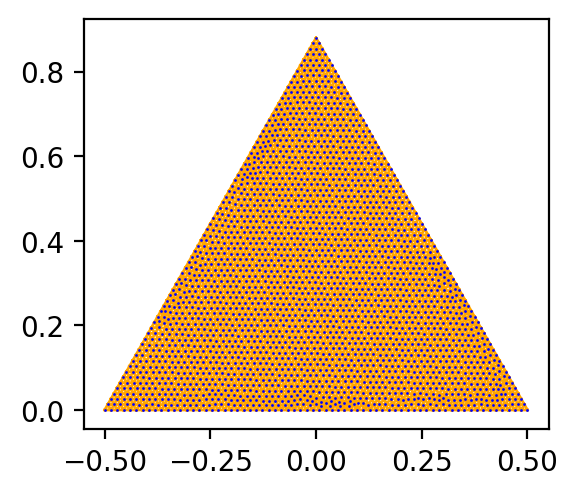

In [13]:
import pygmsh

with pygmsh.geo.Geometry() as geom:
    geom.add_polygon(
        [
            [-0.5, 0.0],
            [0.5, 0.0],
            [0, 0.88],
        ],
        mesh_size=0.015,
    )
    gmesh = geom.generate_mesh()

# mesh.points, mesh.cells, ...
# mesh.write("out.vtk")

points = gmesh.points[:,0:2]  # this  gives us the xy positions, dumping the useless z part 
triangles = gmesh.cells[1].data # this gives us the triangles 
#points = mcirc.p.T;   # nodes in format suitable for triplot
#simps = mcirc.t.T;  # triangle simplices in format suitable for triplot 
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=200)
ax.triplot(points[:,0], points[:,1], triangles,markersize=2, marker='.',lw=1,color='orange',mfc='blue',mew=0)
ax.set_aspect('equal')

mesh = skfem.MeshTri(points.T, triangles.T)  # uses meshio format for cellblocks!
plt.show()

In [14]:
rmax = 200 
bmesh = mesh.translated(rmax * mesh.p) # expand the mesh to be larger 
# set up the basis 
element = skfem.ElementTriP1()  # or ElementTriP2?  a triangular element
basis = skfem.Basis(bmesh, element)

/var/folders/l_/tk7gphlj0d38754sb6x8p1f00000gn/T/ipykernel_26578/2091092280.py:16: SparseEfficiencyWarning: splu converted its input to CSC format
  backsolve = splu(A_csc.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)


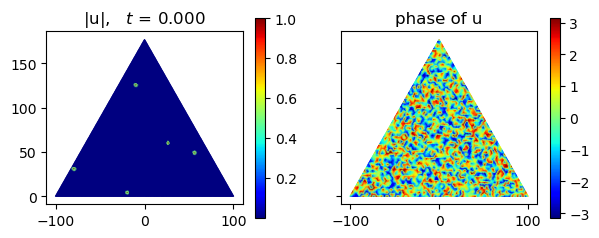

(<Figure size 600x300 with 4 Axes>,
 array([<Axes: title={'center': '|u|,   $t$ = 0.000'}>,
        <Axes: title={'center': 'phase of u'}>], dtype=object))

In [17]:
alpha = 2.  # must be defined here to make the Laplacian op    alpha = c_1 = b_1 of the different forms
D_u  = (1 + 1.j*alpha)  #diffusion coefficient 
dt = .005    # timestep 

L = -D_u * skfem.asm(laplace, basis)   # Laplacian for u field 
M = skfem.asm(mass, basis)  # mass matrix (sizes of triangles) 

theta = 0.5                     # Crank–Nicolson algorithm for a diffusion PDE
A = M - theta * L * dt
B = M + (1. - theta) * L * dt

epsilon = 1e-10
A_csc = scipy.sparse.csc_matrix(A)
A_csc += epsilon * np.eye(A_csc.shape[0])

backsolve = splu(A_csc.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)

# the extra function:
def g(u,b_3):
    return (u-(b_3 -1j)*np.absolute(u)*np.absolute(u)*u)   # Chate's form 

# make different initial conditions for u field
nnodes = len(basis.doflocs[0])
u_init2 = np.zeros(nnodes, dtype = complex)
u_init2 += 1e-5*np.random.uniform(low=-1,high=1,size=nnodes)*1j
u_init2 += 1e-5*np.random.uniform(low=-1,high=1,size=nnodes)
for i in range(5):
    j  = np.random.randint(0,nnodes)
    u_init2[j] = 1.0 + 0.02j
t=0
disp(bmesh,u_init2,basis,t)

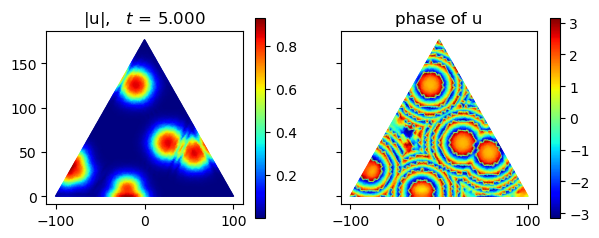

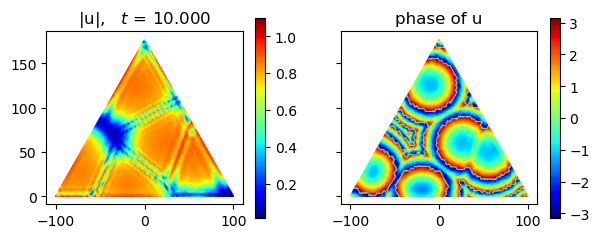

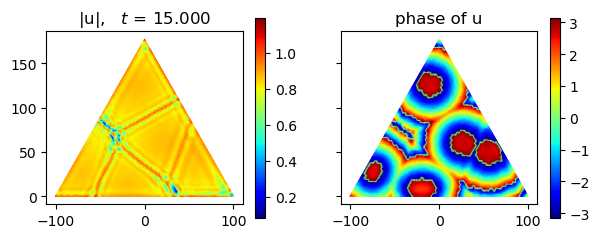

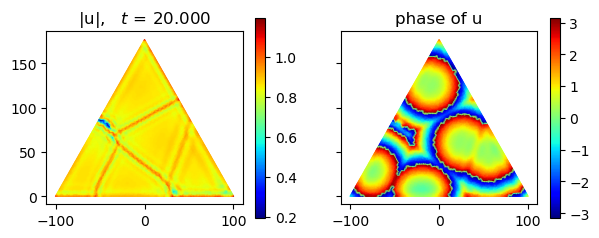

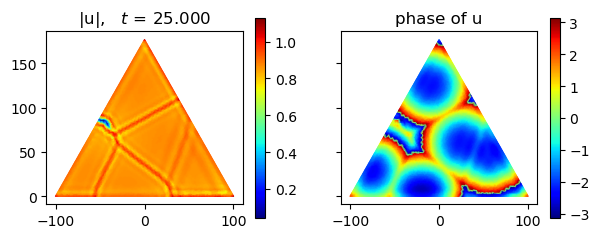

In [18]:
u = u_init2;  t=0; 
b_3 = 1.3 # choose a nice param

for j in range(5):
    for i in range(1000):
        t, u = one_step(t,u,b_3)  
    disp(bmesh,u,basis,t)

In [19]:
alpha = 0.  # must be defined here to make the Laplacian op    alpha = c_1 = b_1 of the different forms
D_u  = (1 + 1.j*alpha)/5  #diffusion coefficient 
dt = .01    # timestep 

L = -D_u * skfem.asm(laplace, basis)   # Laplacian for u field 
M = skfem.asm(mass, basis)  # mass matrix (sizes of triangles) 

theta = 0.5                     # Crank–Nicolson algorithm for a diffusion PDE
A = M - theta * L * dt
B = M + (1. - theta) * L * dt

epsilon = 1e-10
A_csc = scipy.sparse.csc_matrix(A)
A_csc += epsilon * np.eye(A_csc.shape[0])

backsolve = splu(A_csc.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)


/var/folders/l_/tk7gphlj0d38754sb6x8p1f00000gn/T/ipykernel_26578/875302096.py:16: SparseEfficiencyWarning: splu converted its input to CSC format
  backsolve = splu(A_csc.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)


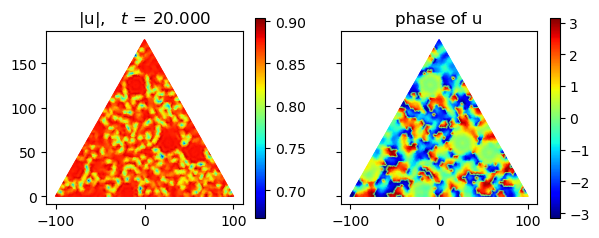

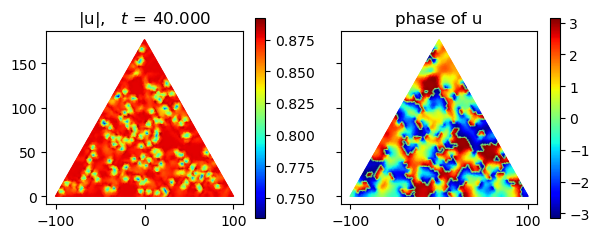

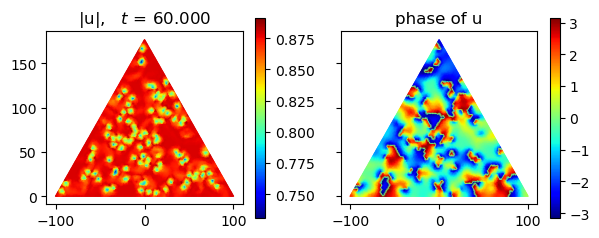

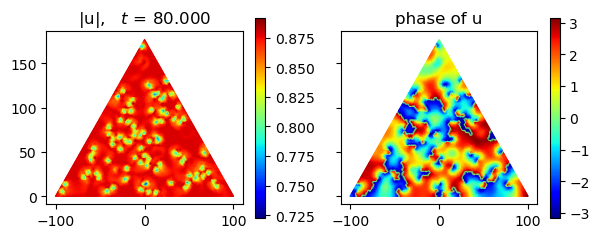

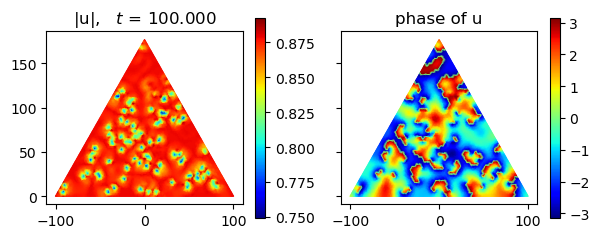

In [20]:
u = u_init2;  t=0; 
b_3 = 1.3 # choose a nice param

for j in range(5):
    for i in range(2000):
        t, u = one_step(t,u,b_3)  
    disp(bmesh,u,basis,t)

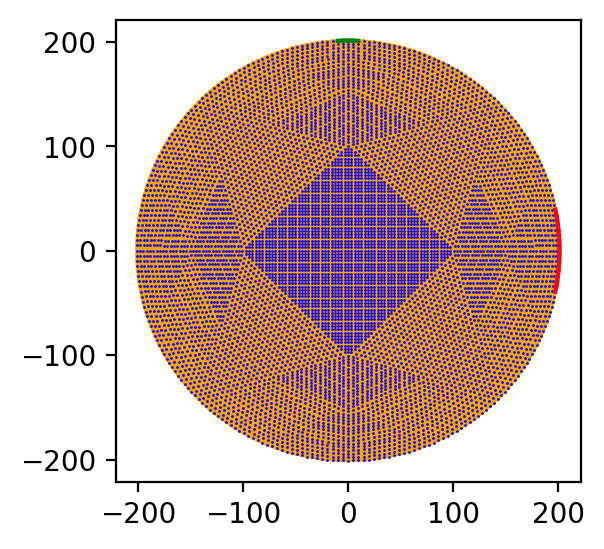

In [21]:
mcirc= skfem.MeshTri.init_circle(6,smoothed=False)  # make a triangular mesh of the unit circle, number is refinement level
#mcirc # show the mesh
mcirc = mcirc.with_boundaries({"rrright": lambda x: np.logical_and(x[0] > 0.9,np.abs(x[1]) < 0.2), \
                               "tttop": lambda x: np.logical_and(x[1] > 0.93,np.abs(x[0]) < 0.04) })
# if you want complement of a list, use np.setdiff1d

rmax = 200 
mcirc = mcirc.translated(rmax * mcirc.p) # expand the mesh to be larger 

# extract facet endpoints given a facet index 
def dr_facet(mesh, ifacet):
    facet = mesh.facets[:,ifacet]  # a particular facet 
    i1 = facet[0]
    i2 = facet[1]
    #print(i1,i2)
    xvals = mcirc.p[0]; yvals = mcirc.p[1]
    x1 = xvals[i1]; x2 = xvals[i2] 
    y1 = yvals[i1]; y2 = yvals[i2] 
    xx = np.array([x1,x2])
    yy = np.array([y1,y2])
    return xx,yy

# show our chosen boundaries 
points = mcirc.p.T;   # nodes in format suitable for triplot
simps = mcirc.t.T;  # triangle simplices in format suitable for triplot 
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=200)
ax.triplot(points[:,0], points[:,1], simps,markersize=2, marker='.',lw=1,color='orange',mfc='blue',mew=0)
for i in mcirc.boundaries['rrright']:
    xx,yy = dr_facet(mcirc,i)
    ax.plot(xx,yy, 'r-')   
for i in mcirc.boundaries['tttop']:
    xx,yy = dr_facet(mcirc,i)
    ax.plot(xx,yy, 'g-')  # yup this is what I wanted! 
plt.show()

In [22]:
element = skfem.ElementTriP2()  # or ElementTriP2?  a triangular element
basis = skfem.Basis(mcirc, element)

Dt = basis.get_dofs({'tttop'})  # for a Dirichlet boundary condition on the top
rbasis = skfem.FacetBasis(mcirc, element, facets=mcirc.boundaries['rrright'])   # for Neumann condition on the right

@skfem.LinearForm
def rhs(v,_):
    return 1.0 * v

# the extra function:
def g(u,b_3):
    return (u-(b_3 -1j)*np.absolute(u)*np.absolute(u)*u)   # Chate's form 

# split integrator, crank nicholson for the diffusion parts and simply adding in the 
# non-linear function terms by hand afterwards 
# do a single timestep, return u fields and time 
# requires globals: dt, backsolve,  B
# note alpha, dt are used in definition of B and backsolve 
def one_step(t,u,beta):
    t += dt
    u = backsolve(B @ u + Bint)    
    u += g(u,beta)*dt
    return t,u

In [23]:
alpha = 2.  # must be defined here to make the Laplacian op    alpha = c_1 = b_1 of the different forms
D_u  = (1 + 1.j*alpha)  #diffusion coefficient 
dt = .01    # timestep 

L = -D_u * skfem.asm(laplace, basis)   # Laplacian for u field 
M = skfem.asm(mass, basis)  # mass matrix (sizes of triangles) 

L_d = skfem.penalize(L, D=Dt)  # sets boundary to zero Dirichlet boundary on dofs of chosen boundary 
M0   =  skfem.penalize(M  , D=Dt) 

theta = 0.5                     # Crank–Nicolson algorithm for a diffusion PDE
A = M0 - theta * L_d * dt
B = M0 + (1. - theta) * L_d * dt

backsolve = splu(A.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)

u_nb = 5e-3 + 0.1j # normal components of slopes for Neumann BC regions 
Bint = skfem.asm(rhs,rbasis) *dt * D_u * u_nb

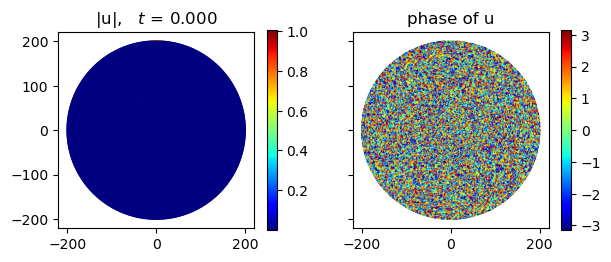

(<Figure size 600x300 with 4 Axes>,
 array([<Axes: title={'center': '|u|,   $t$ = 0.000'}>,
        <Axes: title={'center': 'phase of u'}>], dtype=object))

In [24]:
# make different initial conditions for u field
nnodes = len(basis.doflocs[0])
u_init2 = np.zeros(nnodes, dtype = complex)
u_init2 += 1e-5*np.random.uniform(low=-1,high=1,size=nnodes)*1j
u_init2 += 1e-5*np.random.uniform(low=-1,high=1,size=nnodes)
for i in range(5):
    j  = np.random.randint(0,nnodes)
    u_init2[j] = 1.0 + 0.02j
u_init2[Dt] = 1.0 + 0.1j # set initial conditions on boundary tttop to something else
t=0
disp(mcirc,u_init2,basis,t)

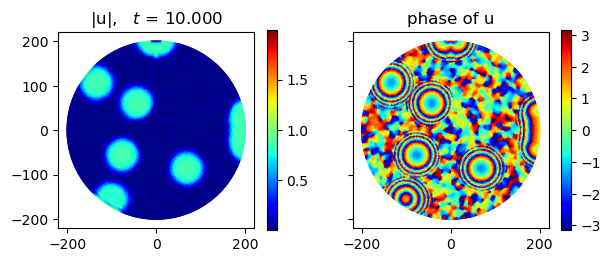

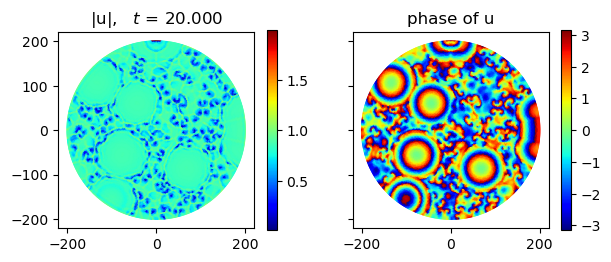

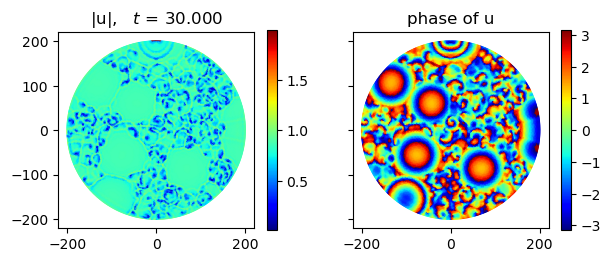

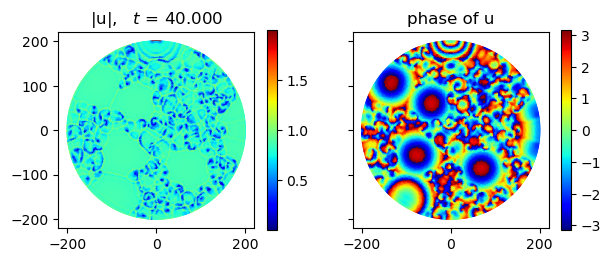

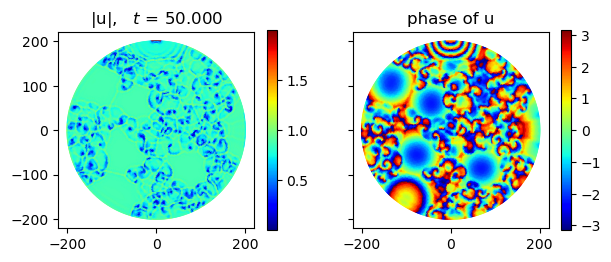

In [25]:
u = np.copy(u_init2);  t=0; 
b_3 = 1.3 # choose a nice param

for j in range(5):
    for i in range(1000):
        t, u = one_step(t,u,b_3)  
    disp(mcirc,u,basis,t)

In [26]:
u = np.copy(u_init2);  t=0.; 
b_3 = 1.3 # choose a nice param

makemovie==0
if (makemovie==1):
    nmax = 6000
    dn = int(nmax/100)
    dd = int(nmax/dn)
    froot = 'GL_var_a'
    for i in range(dd):
        mkpngs(froot,i,mcirc,u,basis,t)
        for j in range(dn):
            t, u = one_step(t,u,b_3)  
    mkpngs(froot,i+1,mcirc,u,basis,t)


else:
    for j in range(5):
        for i in range(1000):
            t, u = one_step(t,u,b_3)  
        disp(mcirc,u,basis,t)

NameError: name 'makemovie' is not defined

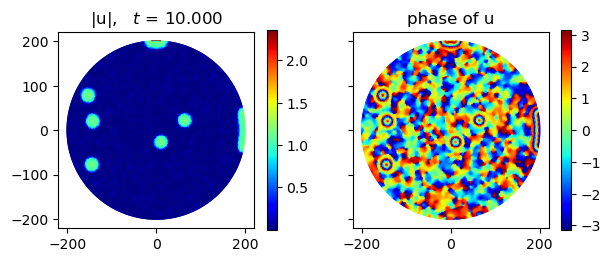

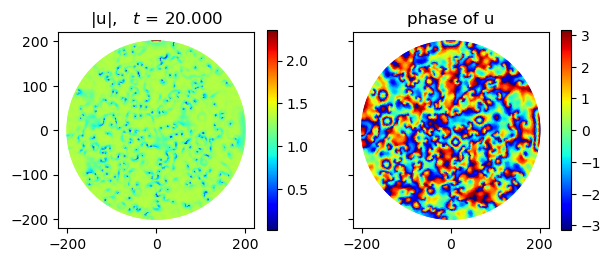

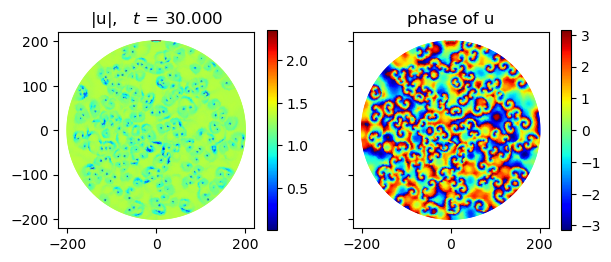

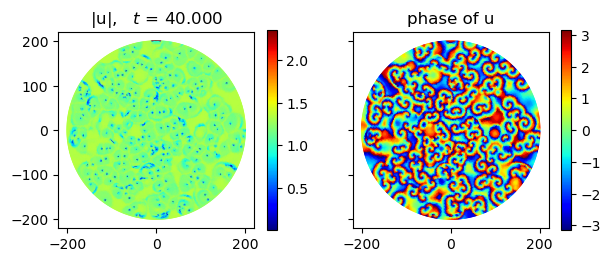

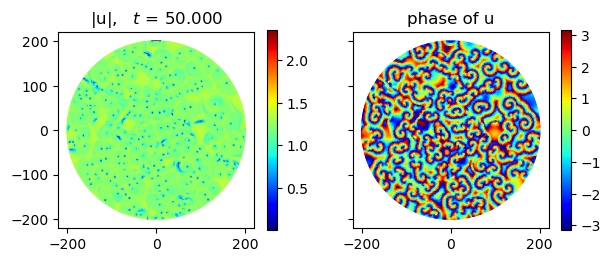

In [73]:
alpha = 0.  # must be defined here to make the Laplacian op    alpha = c_1 = b_1 of the different forms
D_u  = (1 + 1.j*alpha)  #diffusion coefficient 
dt = .01    # timestep 

L = -D_u * skfem.asm(laplace, basis)   # Laplacian for u field 
M = skfem.asm(mass, basis)  # mass matrix (sizes of triangles) 

L_d = skfem.penalize(L, D=Dt)  # sets boundary to zero Dirichlet boundary on dofs of chosen boundary 
M0   =  skfem.penalize(M  , D=Dt) 

theta = 0.5                     # Crank–Nicolson algorithm for a diffusion PDE
A = M0 - theta * L_d * dt
B = M0 + (1. - theta) * L_d * dt

backsolve = splu(A.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)

u_nb = -2e-2 + 0.1j  # normal components of slopes for Neumann BC regions 
Bint = skfem.asm(rhs,rbasis) *dt * D_u * u_nb

u = np.copy(u_init2);  t=0; 
b_3 = 0.56 # choose a nice param

for j in range(5):
    for i in range(1000):
        t, u = one_step(t,u,b_3)  
    disp(mcirc,u,basis,t)

Transforming over 1000 vertices to C_CONTIGUOUS.
Transforming over 1000 elements to C_CONTIGUOUS.


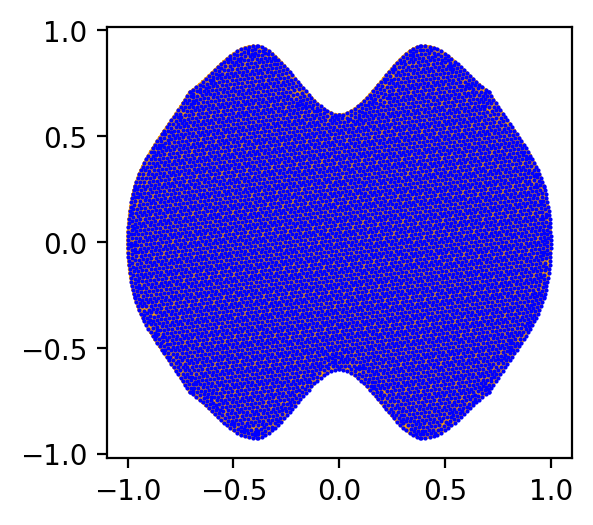

In [12]:
# make a 4 point arc between phi1, and phi2
def mkarc(phi1,phi2,nphi):
    #nphi = 4
    dphi = (phi2-phi1)/(nphi-1)
    ptlist = np.zeros((nphi,2))
    for i in range(nphi):
        phi = phi1 + dphi*i
        ptlist[i,0] = np.cos(phi)
        ptlist[i,1] = np.sin(phi)
    return ptlist

import pygmsh
# make a mesh with some splines
with pygmsh.geo.Geometry() as geom:
    lcar = 0.02  # sets refinement level
    arc1 = mkarc( -np.pi/4,  np.pi/4,4)
    ps = geom.add_point( np.squeeze(arc1[0,:]) , lcar)
    p2 = geom.add_point( np.squeeze(arc1[1,:]) , lcar)
    p3 = geom.add_point( np.squeeze(arc1[2,:]) , lcar)
    pe = geom.add_point( np.squeeze(arc1[3,:]) , lcar)
    s1 = geom.add_spline([ps, p2, p3, pe])
    
    arc2 = mkarc( np.pi/4,3*np.pi/4,5)
    p1 = geom.add_point( np.squeeze(arc2[0,:]) , lcar)
    p2 = geom.add_point( np.squeeze(arc2[1,:]) , lcar)
    #p3 = geom.add_point( np.squeeze(arc2[2,:]) , lcar)
    p4 = geom.add_point( np.squeeze(arc2[3,:]) , lcar)
    pe2 = geom.add_point( np.squeeze(arc2[4,:]) , lcar)
    q1 = geom.add_point([0.0, 0.6], lcar)
    s2 = geom.add_spline([pe, p2, q1, p4, pe2])

    arc3 = mkarc(3*np.pi/4,5*np.pi/4,4)
    p1 = geom.add_point( np.squeeze(arc3[0,:]) , lcar)
    p2 = geom.add_point( np.squeeze(arc3[1,:]) , lcar)
    p3 = geom.add_point( np.squeeze(arc3[2,:]) , lcar)
    pe3 = geom.add_point( np.squeeze(arc3[3,:]) , lcar)
    s3 = geom.add_spline([pe2, p2, p3, pe3])

    arc4 = mkarc(5*np.pi/4,7*np.pi/4,5)
    p1 = geom.add_point( np.squeeze(arc4[0,:]) , lcar)
    p2 = geom.add_point( np.squeeze(arc4[1,:]) , lcar)
    #p3 = geom.add_point( np.squeeze(arc4[2,:]) , lcar)
    p4 = geom.add_point( np.squeeze(arc4[3,:]) , lcar)
    pe4 = geom.add_point( np.squeeze(arc4[4,:]) , lcar)
    q2 = geom.add_point([0.0, -0.6], lcar)
    
    s4 = geom.add_spline([pe3, p2, q2, p4, ps])

    ll = geom.add_curve_loop([s1, s2, s3, s4])
    pl = geom.add_plane_surface(ll) 

    mesh = geom.generate_mesh()

pts = mesh.points
cells = mesh.cells
pts_2d = pts[:,0:2]  # get rid of z part of points 
triangles = np.squeeze(cells[1].data)  # list of triangles 

fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=200)
#ax.plot(pts[:,0],pts[:,1],'o')
ax.triplot(pts_2d[:,0], pts_2d[:,1], triangles,markersize=3, marker='.',lw=1,color='orange',mfc='blue',mew=0)
ax.set_aspect('equal')

new_mesh = skfem.MeshTri(pts_2d.T, triangles.T)  # uses meshio format for cellblocks!

rmax = 200 
new_mesh = new_mesh.translated(rmax * new_mesh.p) # expand the mesh to be larger 
plt.show()

In [13]:
element = skfem.ElementTriP2()  # or ElementTriP1?  a triangular element
basis = skfem.Basis(new_mesh, element)

alpha = 2.  # must be defined here to make the Laplacian op = alpha = c_1 = b_1 of the different forms
D_u  = (1 + 1.j*alpha)  # diffusion coefficient 
dt = .01    # timestep 

L = -D_u * skfem.asm(laplace, basis)   # Laplacian for u field , is a bilinear form dot(grad u,grad v)
M = skfem.asm(mass, basis)  # mass matrix (sizes of triangles) , bilinear form is  u*v

theta = 0.5                     # Crank–Nicolson algorithm for a diffusion PDE
A = M - theta * L * dt
B = M + (1. - theta) * L * dt   # 

epsilon = 1e-10
A_csc = scipy.sparse.csc_matrix(A)
A_csc += epsilon * np.eye(A_csc.shape[0])

backsolve = splu(A_csc.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)

#backsolve = splu(A.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)

# the extra function:
def g(u,b_3):
    #return u-(1.0 + 1j*beta)*np.absolute(u)*np.absolute(u)*u  # Winterbottom's form
    return (u-(b_3 -1j)*np.absolute(u)*np.absolute(u)*u)   # Chate's form 

def one_step(t,u,beta):
    t += dt
    u = backsolve(B @ u)    
    u += g(u,beta)*dt
    return t,u


/var/folders/l_/tk7gphlj0d38754sb6x8p1f00000gn/T/ipykernel_49736/2787291470.py:19: SparseEfficiencyWarning: splu converted its input to CSC format
  backsolve = splu(A_csc.T).solve  # .T as splu prefers CSC which is a sparse matrix format (compressed sparse column)


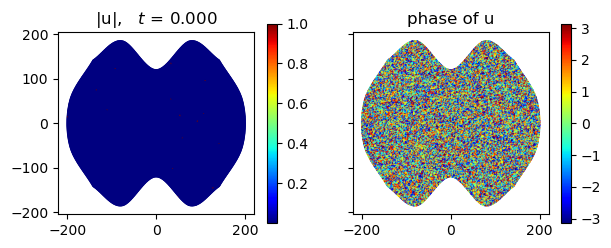

(<Figure size 600x300 with 4 Axes>,
 array([<Axes: title={'center': '|u|,   $t$ = 0.000'}>,
        <Axes: title={'center': 'phase of u'}>], dtype=object))

In [14]:
nnodes = len(basis.doflocs[0])
u_init3 = np.zeros(nnodes, dtype = complex)
u_init3 += 1e-3*np.random.uniform(low=-1,high=1,size=nnodes)*1j
u_init3 += 1e-3*np.random.uniform(low=-1,high=1,size=nnodes)
for i in range(15):
    j  = np.random.randint(0,nnodes)
    u_init3[j] = 1.0 + 0.02j
t=0
disp(new_mesh,u_init3,basis,t)

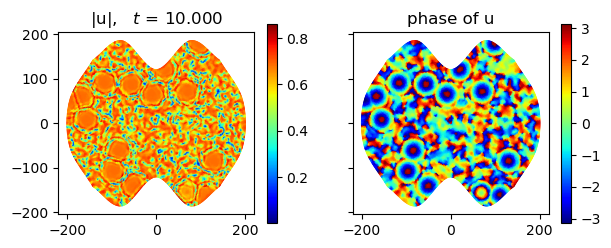

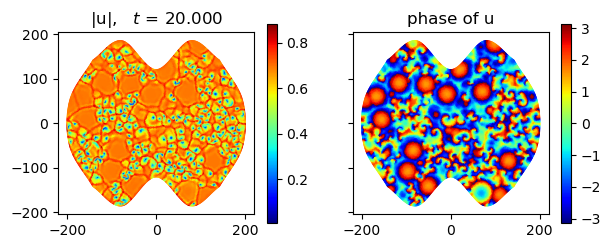

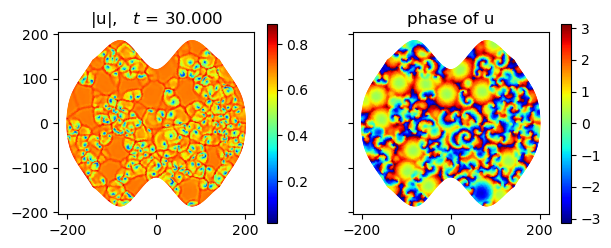

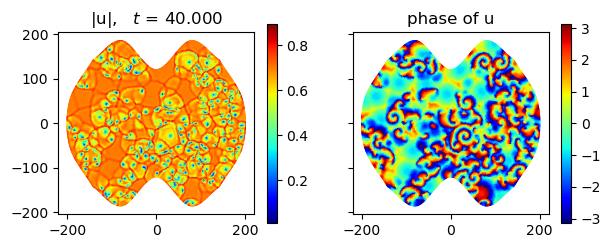

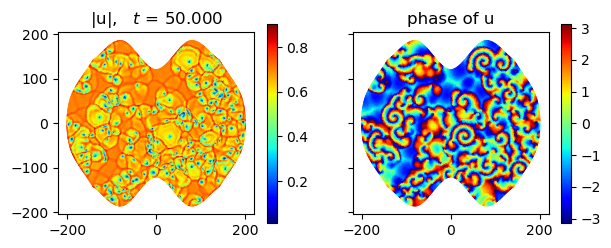

In [85]:
u = np.copy(u_init3);  t=0; Bint=0
b_3 = 2.0 # choose a nice param
for j in range(5):
    for i in range(1000):
        t, u = one_step(t,u,b_3)  
    disp(new_mesh,u,basis,t)

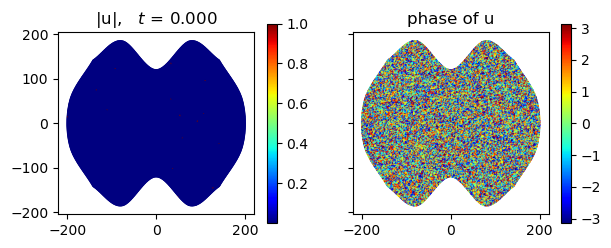

GL_c_000.png


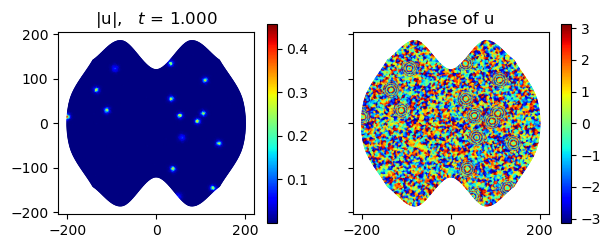

GL_c_001.png


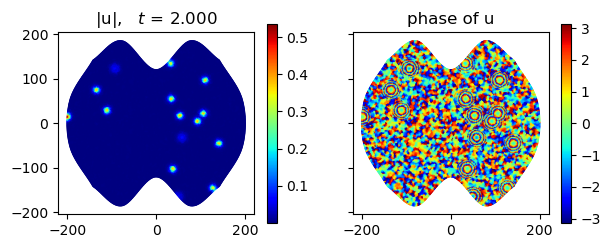

GL_c_002.png


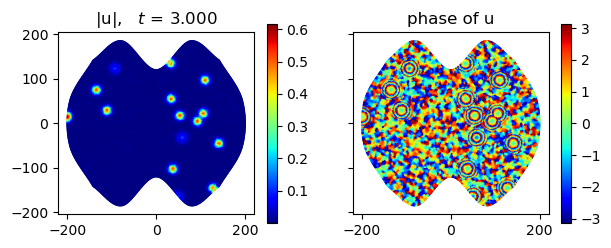

GL_c_003.png


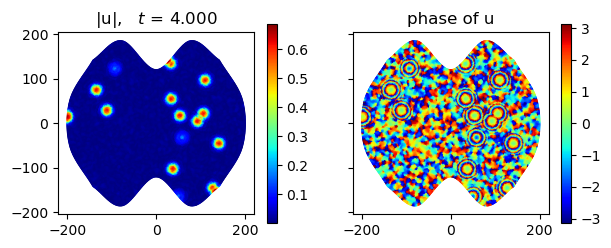

GL_c_004.png


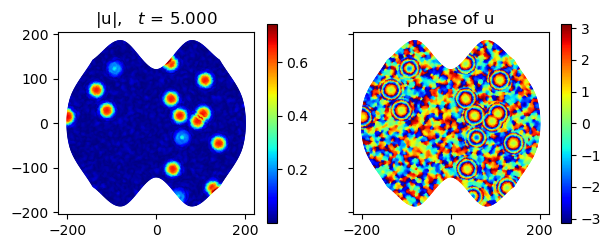

GL_c_005.png


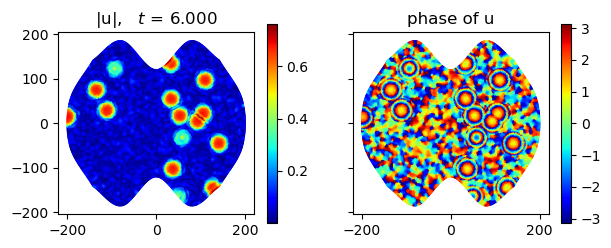

GL_c_006.png


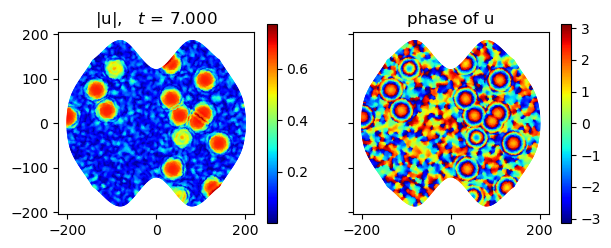

GL_c_007.png


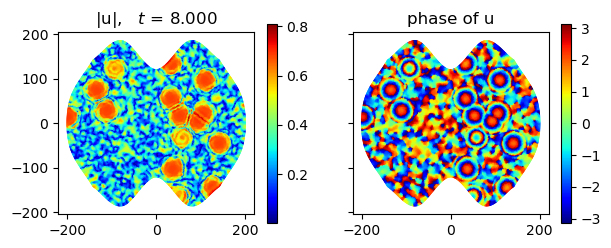

GL_c_008.png


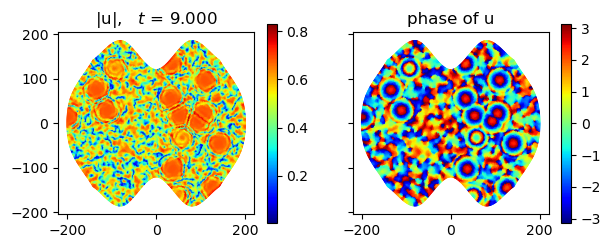

GL_c_009.png


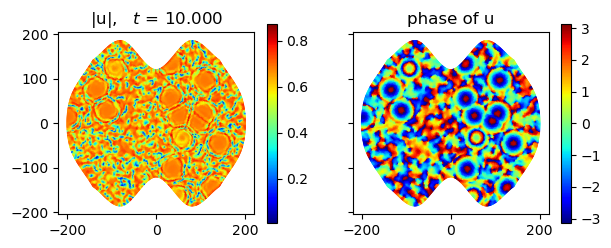

GL_c_010.png


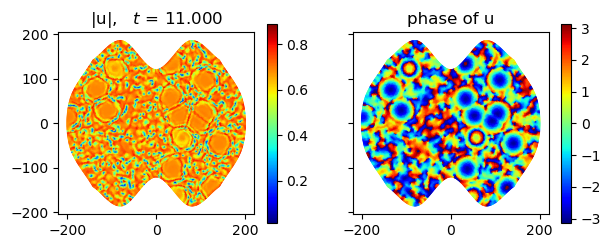

GL_c_011.png


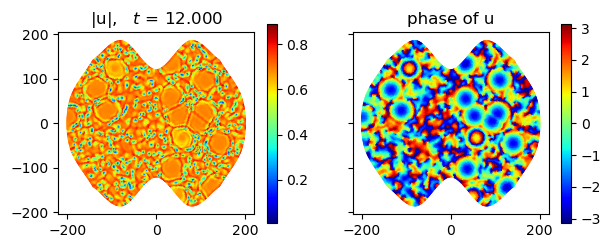

GL_c_012.png


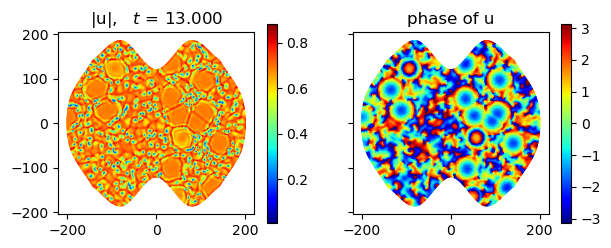

GL_c_013.png


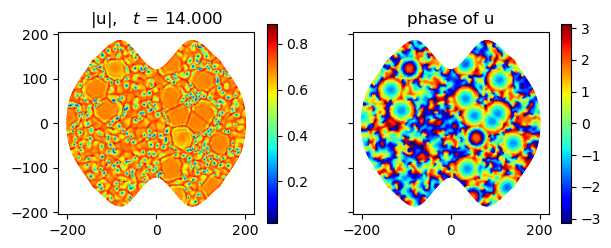

GL_c_014.png


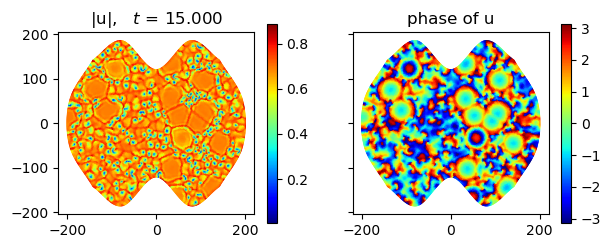

GL_c_015.png


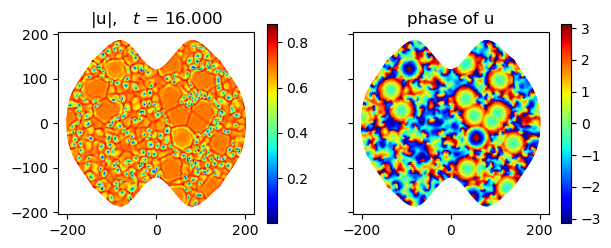

GL_c_016.png


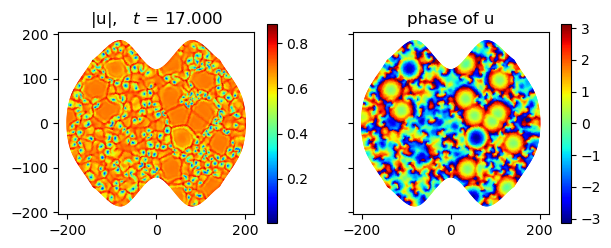

GL_c_017.png


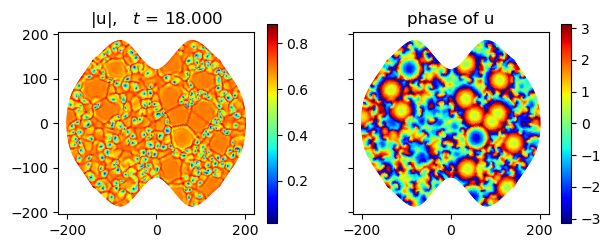

GL_c_018.png


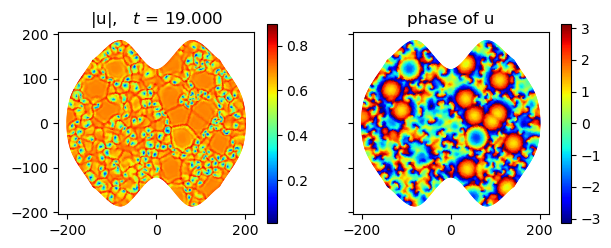

GL_c_019.png


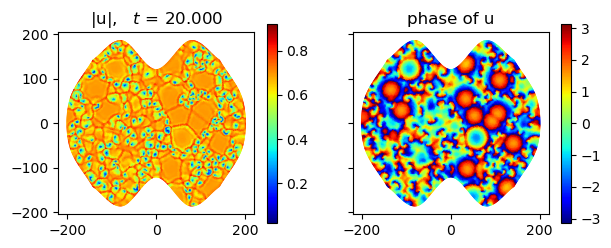

GL_c_020.png


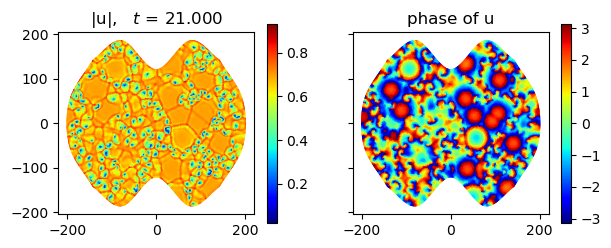

GL_c_021.png


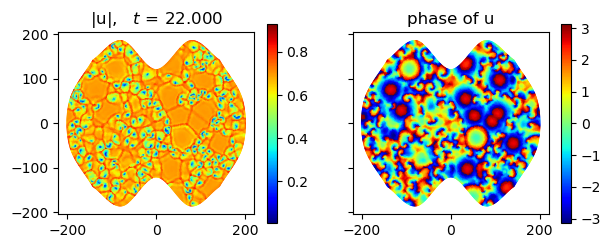

GL_c_022.png


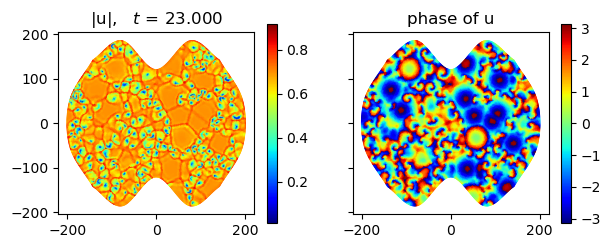

GL_c_023.png


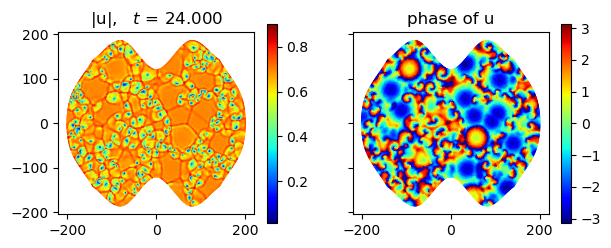

GL_c_024.png


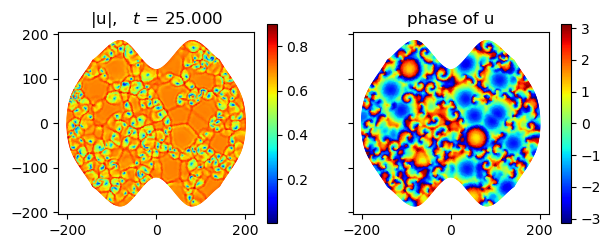

GL_c_025.png


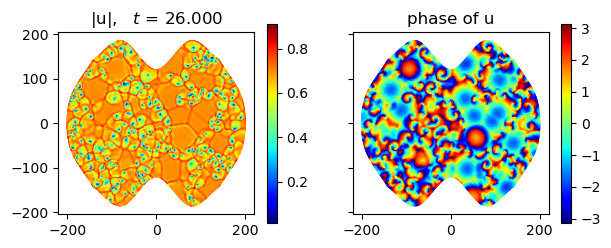

GL_c_026.png


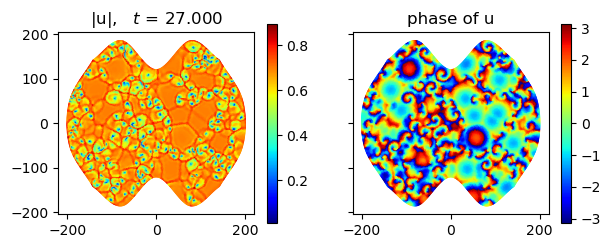

GL_c_027.png


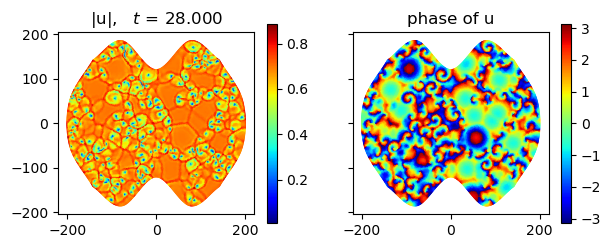

GL_c_028.png


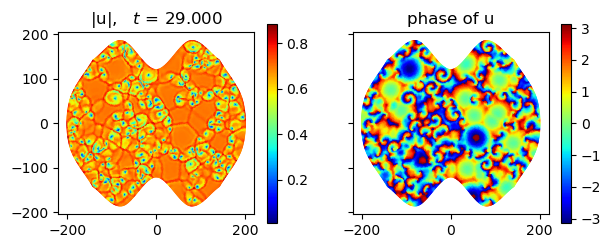

GL_c_029.png


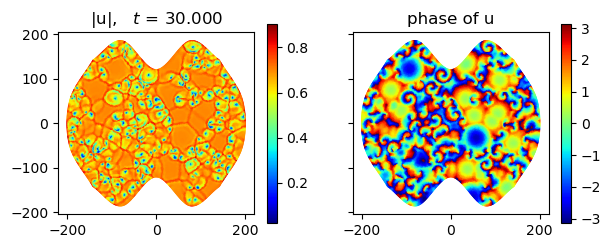

GL_c_030.png


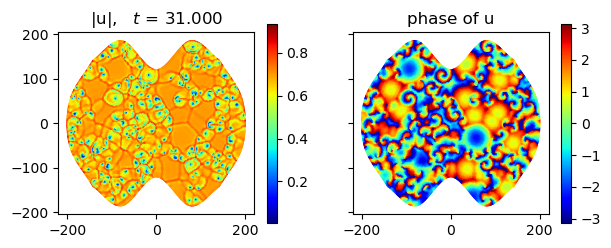

GL_c_031.png


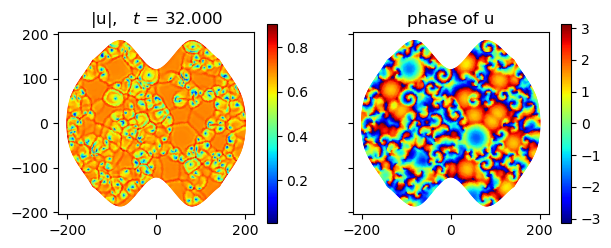

GL_c_032.png


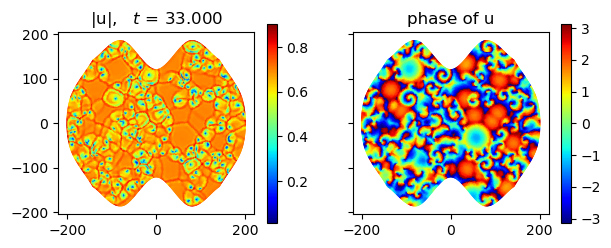

GL_c_033.png


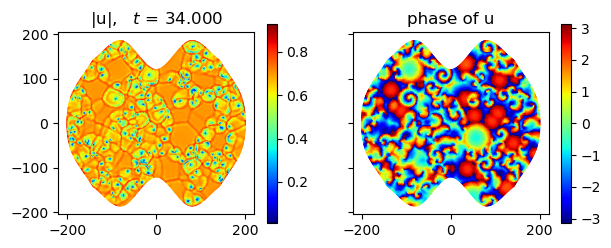

GL_c_034.png


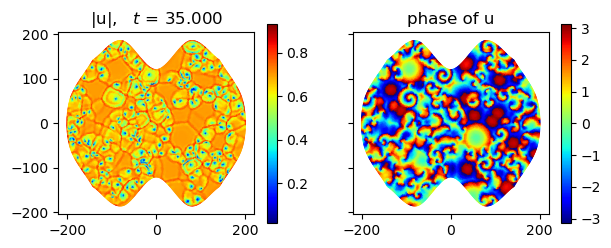

GL_c_035.png


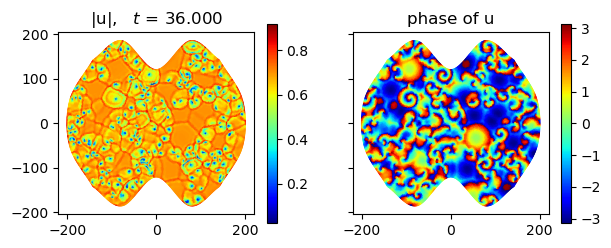

GL_c_036.png


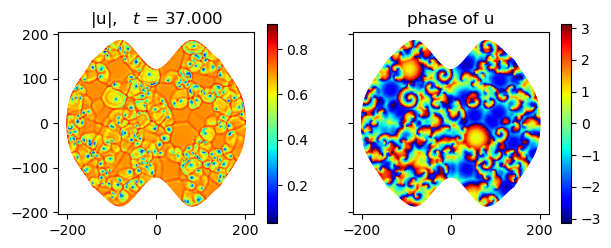

GL_c_037.png


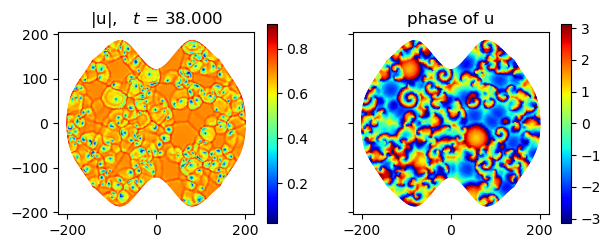

GL_c_038.png


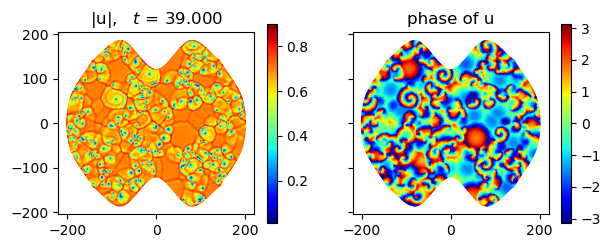

GL_c_039.png


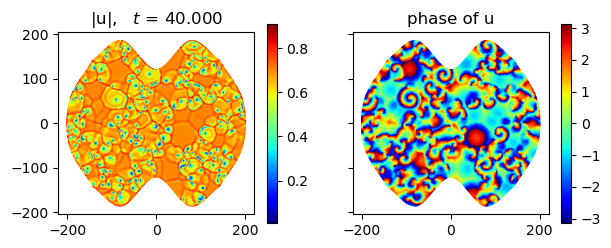

GL_c_040.png


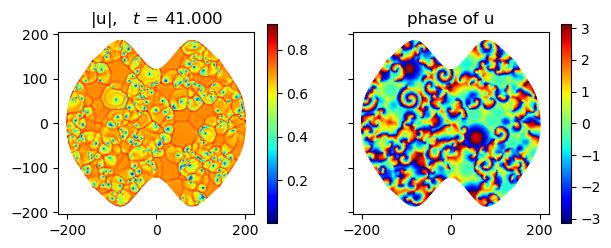

GL_c_041.png


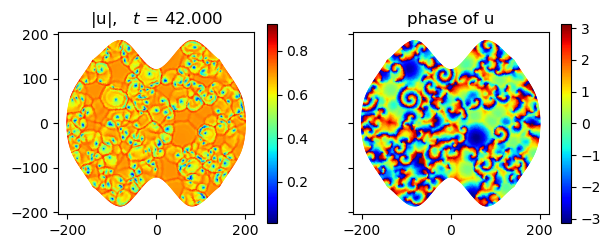

GL_c_042.png


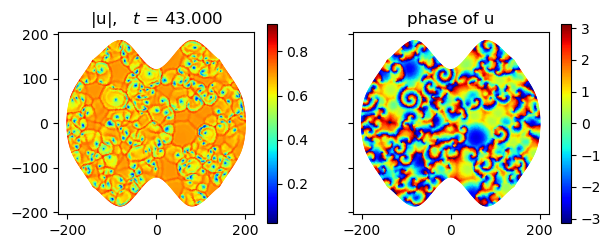

GL_c_043.png


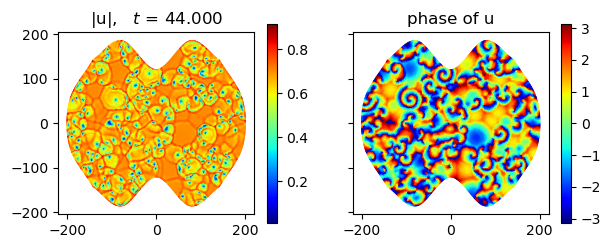

GL_c_044.png


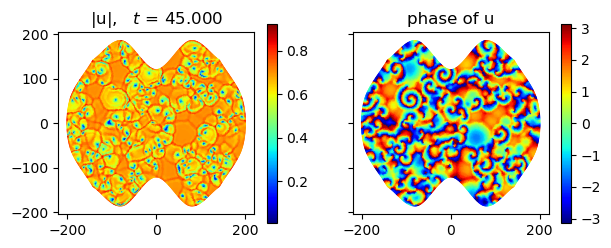

GL_c_045.png


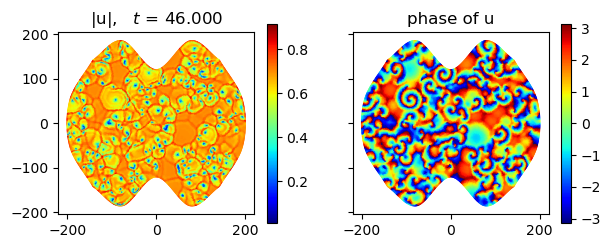

GL_c_046.png


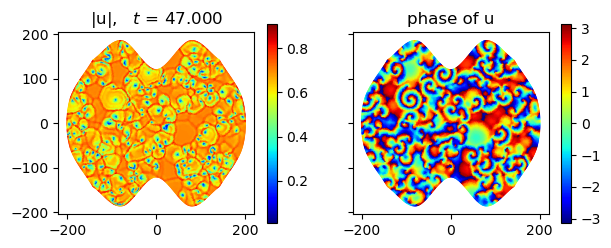

GL_c_047.png


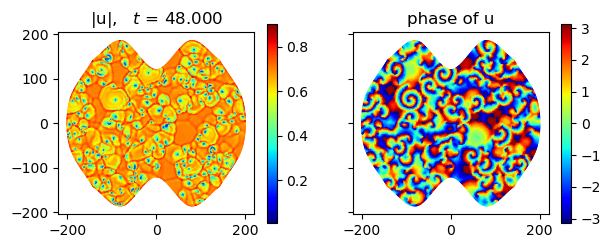

GL_c_048.png


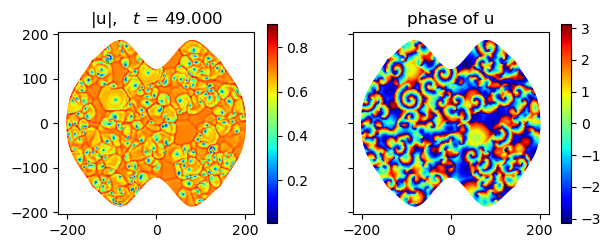

GL_c_049.png


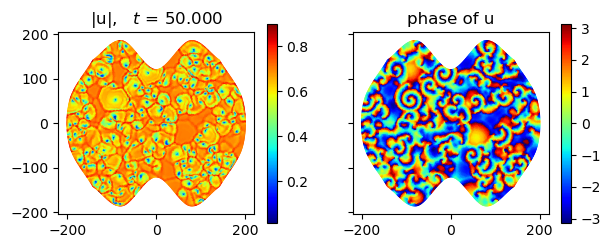

GL_c_050.png


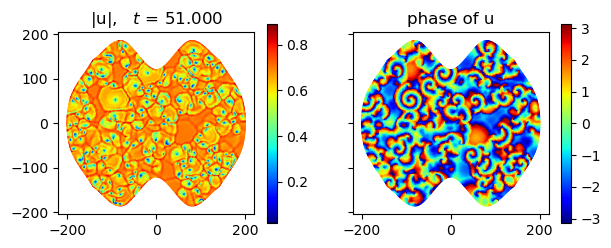

GL_c_051.png


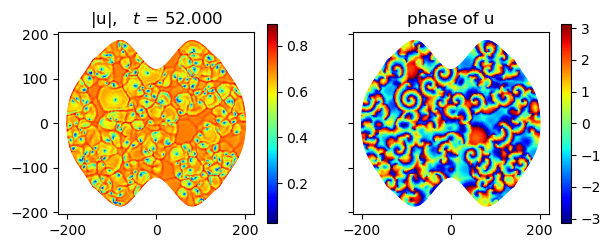

GL_c_052.png


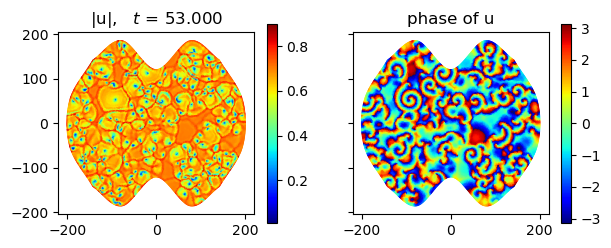

GL_c_053.png


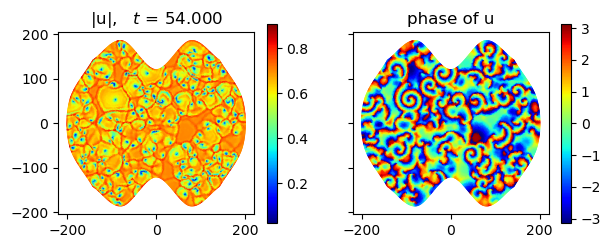

GL_c_054.png


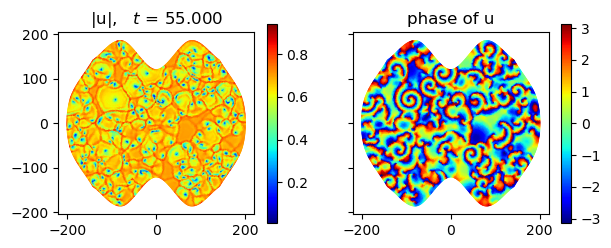

GL_c_055.png


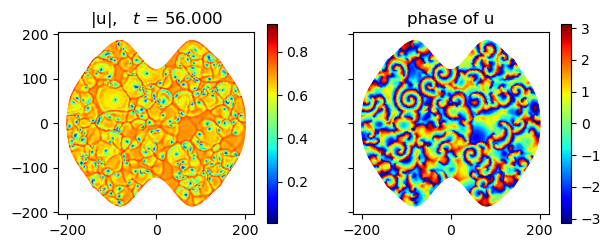

GL_c_056.png


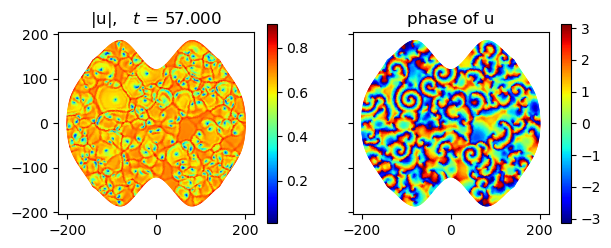

GL_c_057.png


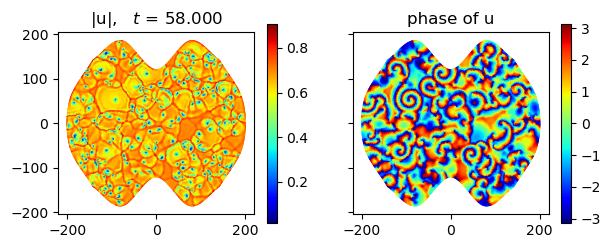

GL_c_058.png


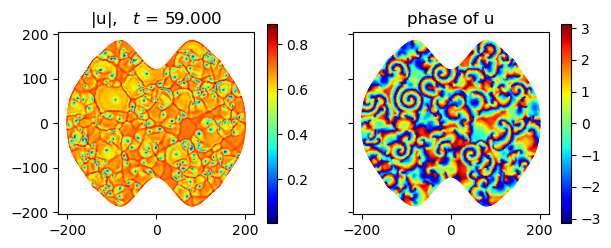

GL_c_059.png


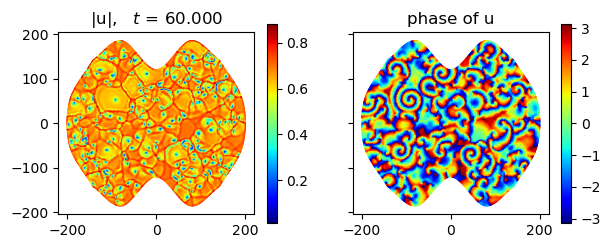

GL_c_060.png


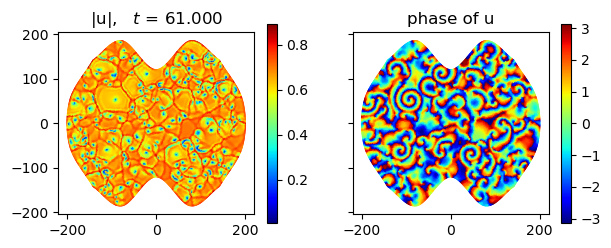

GL_c_061.png


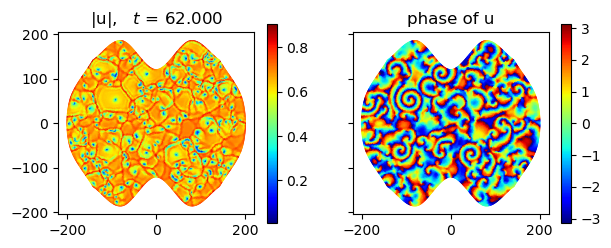

GL_c_062.png


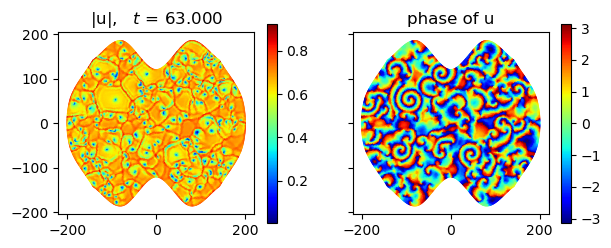

GL_c_063.png


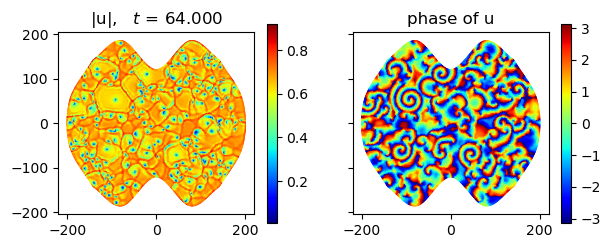

GL_c_064.png


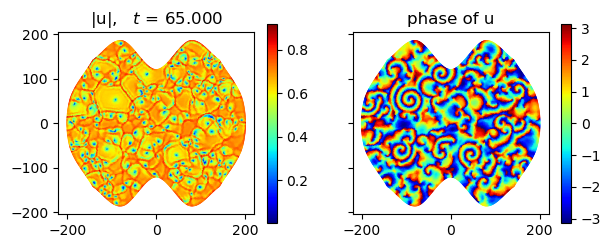

GL_c_065.png


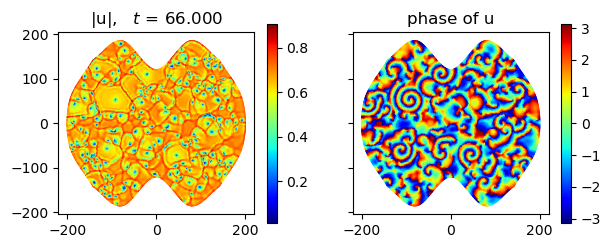

GL_c_066.png


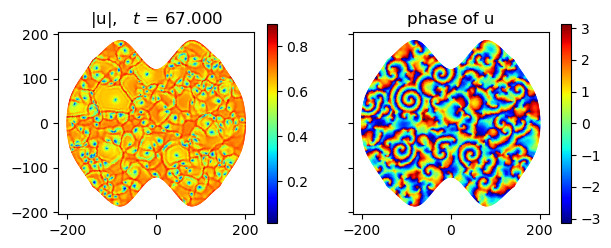

GL_c_067.png


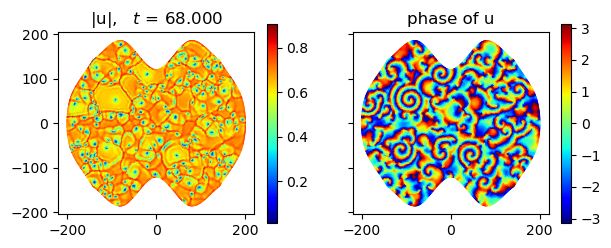

GL_c_068.png


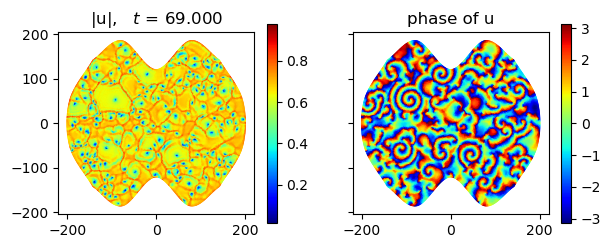

GL_c_069.png


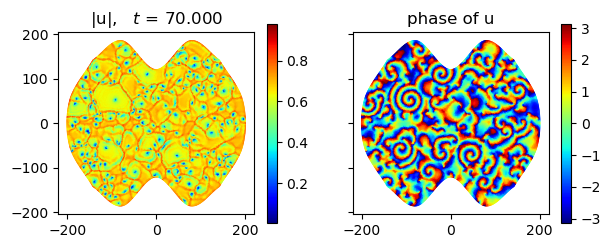

GL_c_070.png


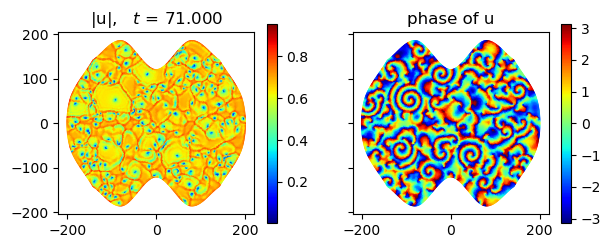

GL_c_071.png


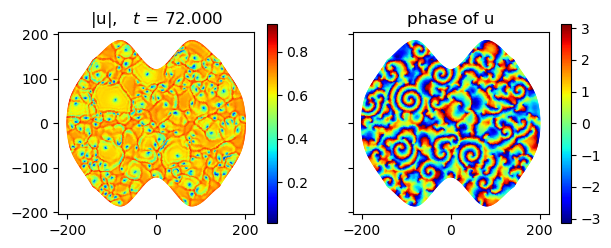

GL_c_072.png


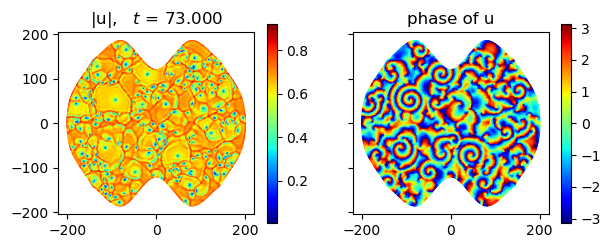

GL_c_073.png


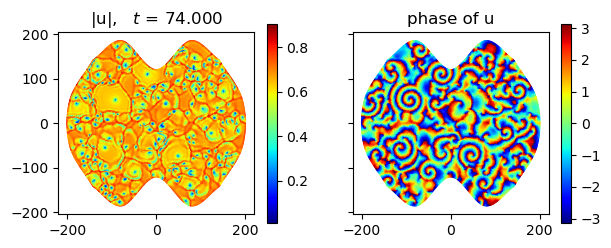

GL_c_074.png


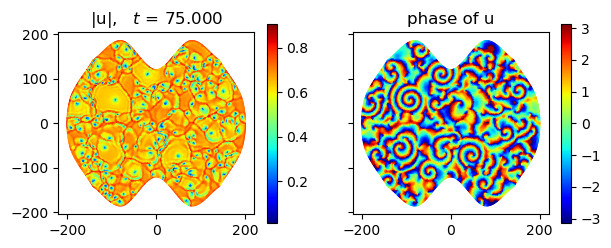

GL_c_075.png


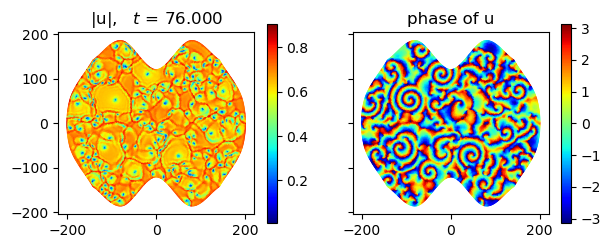

GL_c_076.png


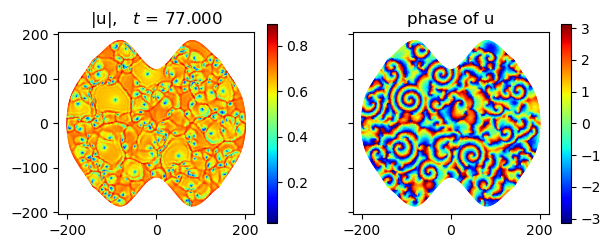

GL_c_077.png


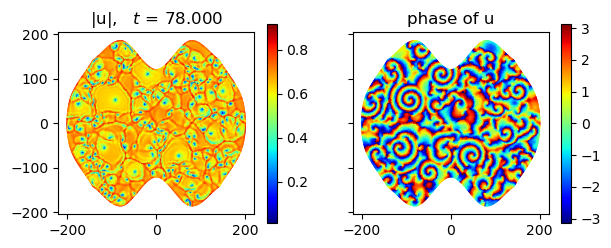

GL_c_078.png


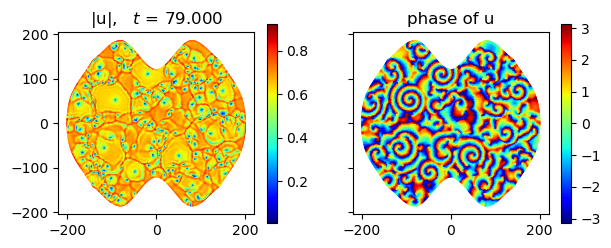

GL_c_079.png


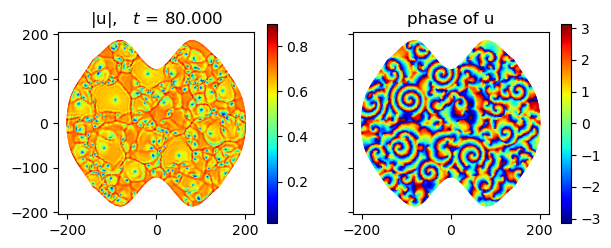

GL_c_080.png


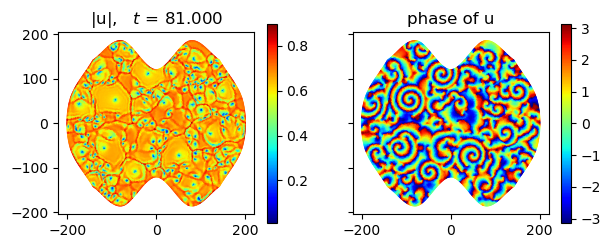

GL_c_081.png


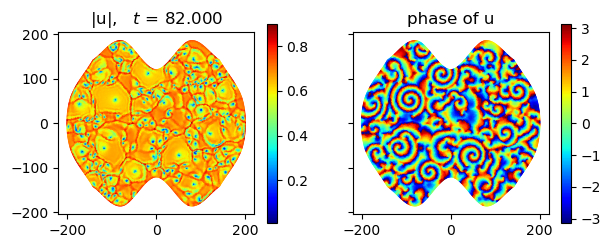

GL_c_082.png


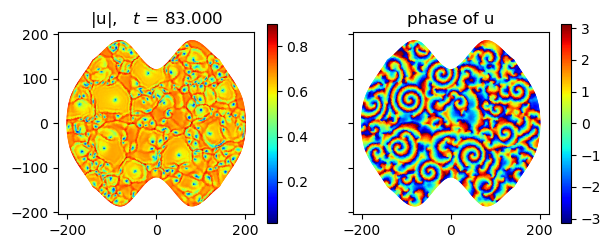

GL_c_083.png


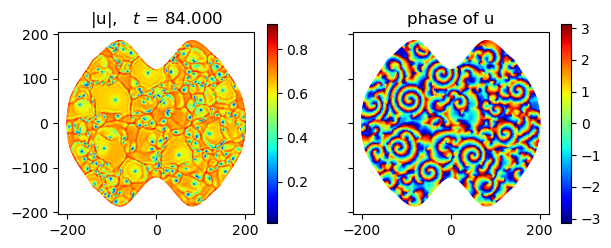

GL_c_084.png


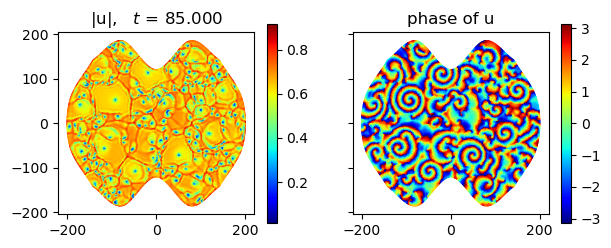

GL_c_085.png


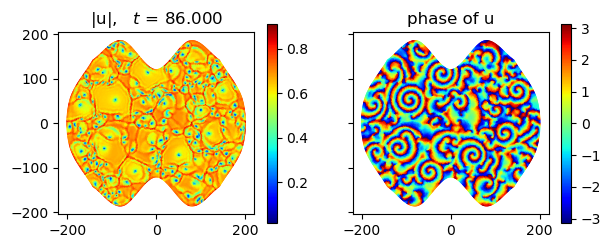

GL_c_086.png


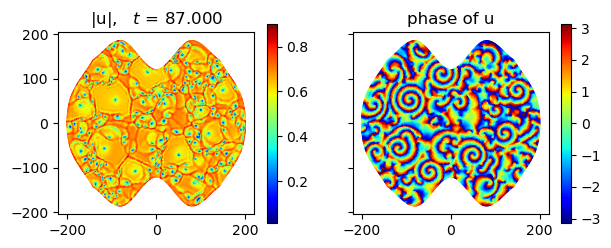

GL_c_087.png


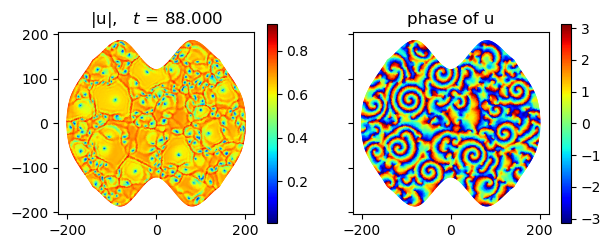

GL_c_088.png


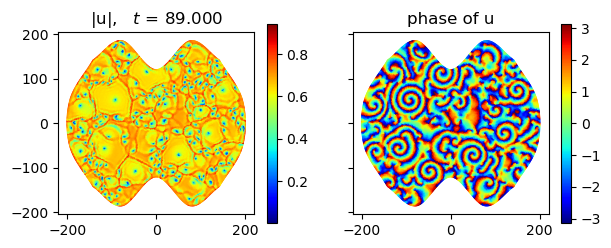

GL_c_089.png


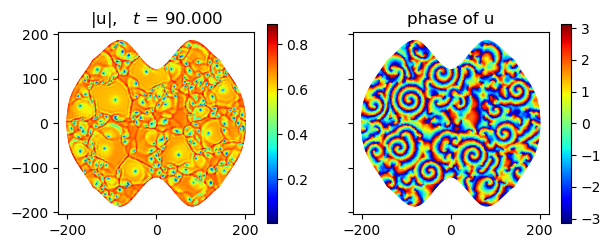

GL_c_090.png


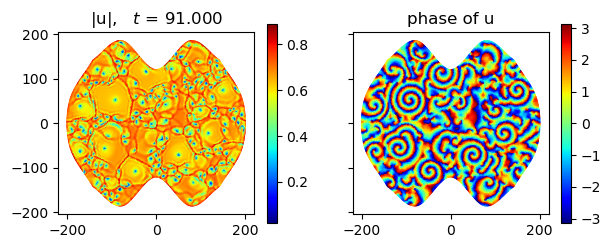

GL_c_091.png


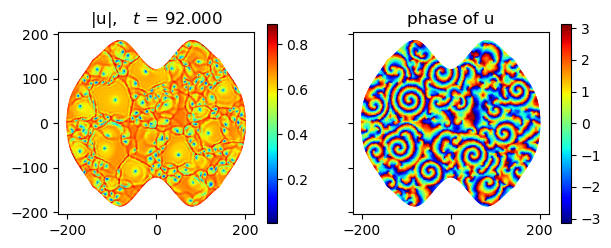

GL_c_092.png


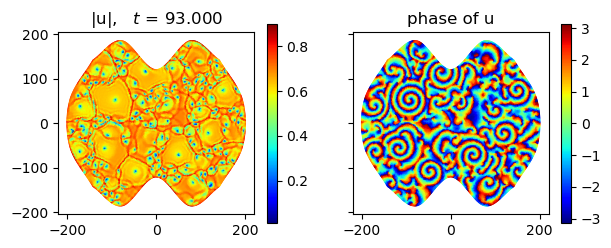

GL_c_093.png


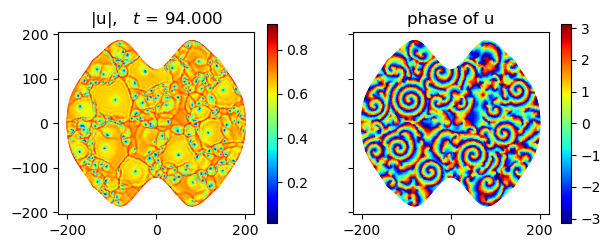

GL_c_094.png


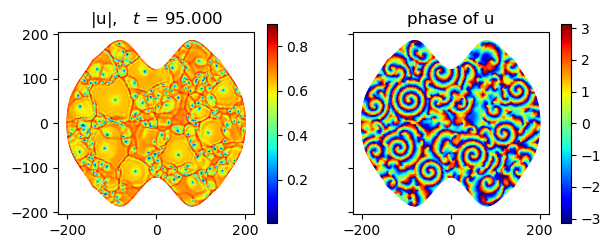

GL_c_095.png


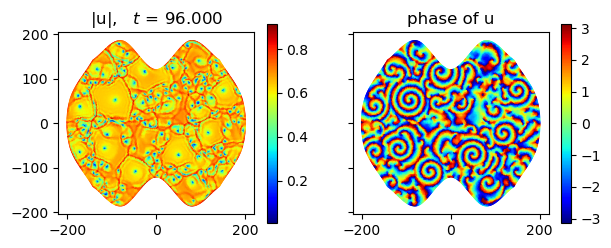

GL_c_096.png


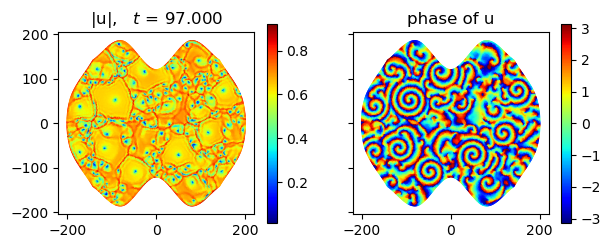

GL_c_097.png


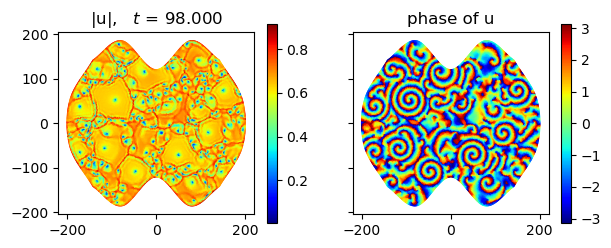

GL_c_098.png


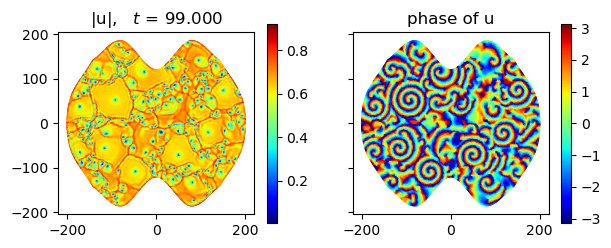

GL_c_099.png


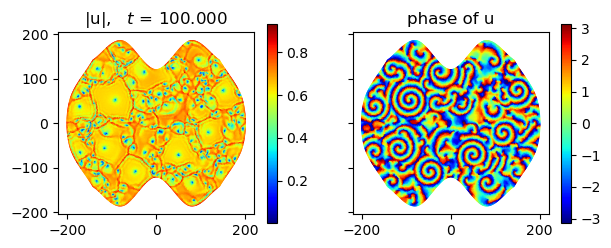

GL_c_100.png


In [15]:
u = u_init3;  t=0; 
b_3 = 2 # choose a nice param
nmax = 10000
dn = int(nmax/100)
dd = int(nmax/dn)
froot = 'GL_c'
for i in range(dd):
    mkpngs(froot,i,new_mesh,u,basis,t)
    for j in range(dn):
        t, u = one_step(t,u,b_3)  
mkpngs(froot,i+1,new_mesh,u,basis,t)

